### Prédiction des dépenses médicales et analyse des profils de risque à partir de données démographiques et socioéconomiques


## Import des bibliothèques

In [4]:
# ==============================
#  Importation des bibliothèques
# ==============================
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import warnings

# =========================
# Clustering et métriques
# =========================
from sklearn.cluster import KMeans, DBSCAN
from sklearn.metrics import silhouette_score, accuracy_score, f1_score, precision_score, recall_score, roc_auc_score, classification_report, confusion_matrix, roc_curve, auc
from scipy.stats import f_oneway

# =========================
# Machine Learning & Préprocessing
# =========================
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.feature_selection import RFE
from xgboost import XGBClassifier
from sklearn.inspection import permutation_importance

# =========================
# Réduction de dimension
# =========================
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import umap.umap_ as umap

# =========================
# Deep Learning / Autoencodeur
# =========================
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense
from tensorflow.keras.optimizers import Adam

# === Style général pour les graphiques ===
sns.set(style="whitegrid")
warnings.filterwarnings("ignore")


## Chargement des données

In [5]:
# ==============================
#  Chargement et exploration des données
# ==============================
 # Lecture du fichier CSV contenant 
df = pd.read_csv("../medical_insurance.csv") 

print("Aperçu des données :")
# Affiche les 10 premières lignes pour un aperçu rapide
display(df.head(10))                        



Aperçu des données :


,person_id,age,sex,region,urban_rural,income,education,marital_status,employment_status,household_size,...,liver_disease,arthritis,mental_health,proc_imaging_count,proc_surgery_count,proc_physio_count,proc_consult_count,proc_lab_count,is_high_risk,had_major_procedure
0,75722,52,Female,North,Suburban,22700.0,Doctorate,Married,Retired,3,...,0,1,0,1,0,2,0,1,0,0
1,80185,79,Female,North,Urban,12800.0,No HS,Married,Employed,3,...,0,1,1,0,0,1,0,1,1,0
2,19865,68,Male,North,Rural,40700.0,HS,Married,Retired,5,...,0,0,1,1,0,2,1,0,1,0
3,76700,15,Male,North,Suburban,15600.0,Some College,Married,Self-employed,5,...,0,0,0,1,0,0,1,0,0,0
4,92992,53,Male,Central,Suburban,89600.0,Doctorate,Married,Self-employed,2,...,0,1,0,2,0,1,1,0,1,0
5,76435,63,Female,North,Rural,305000.0,HS,Single,Employed,3,...,0,0,0,0,0,0,0,1,1,0
6,84005,36,Male,West,Rural,38900.0,Masters,Single,Employed,1,...,0,0,0,1,0,1,0,1,0,0
7,80918,21,Female,South,Suburban,83700.0,HS,Single,Employed,3,...,0,0,0,2,1,0,0,1,0,1
8,60768,53,Male,North,Suburban,60700.0,No HS,Divorced,Retired,1,...,0,0,0,0,0,1,0,1,1,0
9,50075,28,Male,South,Urban,23600.0,Bachelors,Married,Employed,4,...,0,0,0,0,0,2,0,0,0,0


## Aperçu et nettoyage des données

In [6]:
# Informations générales
df.info()

# Statistiques descriptives
df.describe()

# Vérifier les valeurs manquantes
df.isnull().sum()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 54 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   person_id                    100000 non-null  int64  
 1   age                          100000 non-null  int64  
 2   sex                          100000 non-null  object 
 3   region                       100000 non-null  object 
 4   urban_rural                  100000 non-null  object 
 5   income                       100000 non-null  float64
 6   education                    100000 non-null  object 
 7   marital_status               100000 non-null  object 
 8   employment_status            100000 non-null  object 
 9   household_size               100000 non-null  int64  
 10  dependents                   100000 non-null  int64  
 11  bmi                          100000 non-null  float64
 12  smoker                       100000 non-null  object 
 13  

person_id                          0
age                                0
sex                                0
region                             0
urban_rural                        0
income                             0
education                          0
marital_status                     0
employment_status                  0
household_size                     0
dependents                         0
bmi                                0
smoker                             0
alcohol_freq                   30083
visits_last_year                   0
hospitalizations_last_3yrs         0
days_hospitalized_last_3yrs        0
medication_count                   0
systolic_bp                        0
diastolic_bp                       0
ldl                                0
hba1c                              0
plan_type                          0
network_tier                       0
deductible                         0
copay                              0
policy_term_years                  0
p

## Analyse exploratoire simple

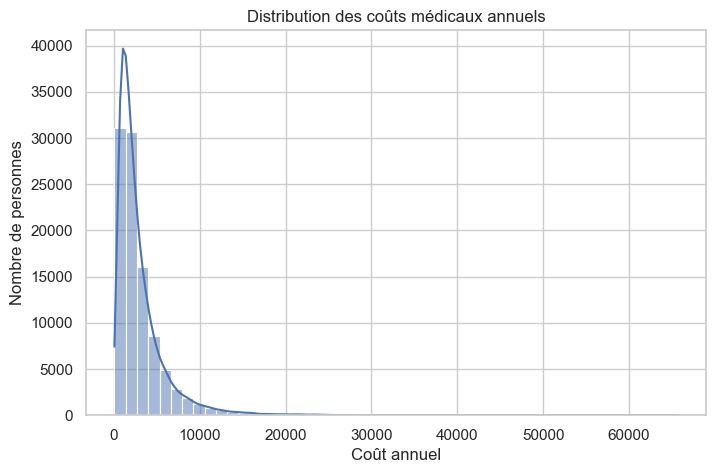

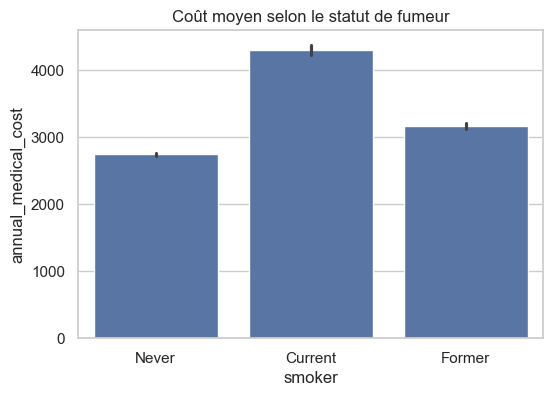

In [7]:
# Distribution des coûts médicaux annuels
plt.figure(figsize=(8,5))
sns.histplot(df['annual_medical_cost'], bins=50, kde=True)
plt.title("Distribution des coûts médicaux annuels")
plt.xlabel("Coût annuel")
plt.ylabel("Nombre de personnes")
plt.show()

# Coût moyen par statut de fumeur
plt.figure(figsize=(6,4))
sns.barplot(x='smoker', y='annual_medical_cost', data=df)
plt.title("Coût moyen selon le statut de fumeur")
plt.show()


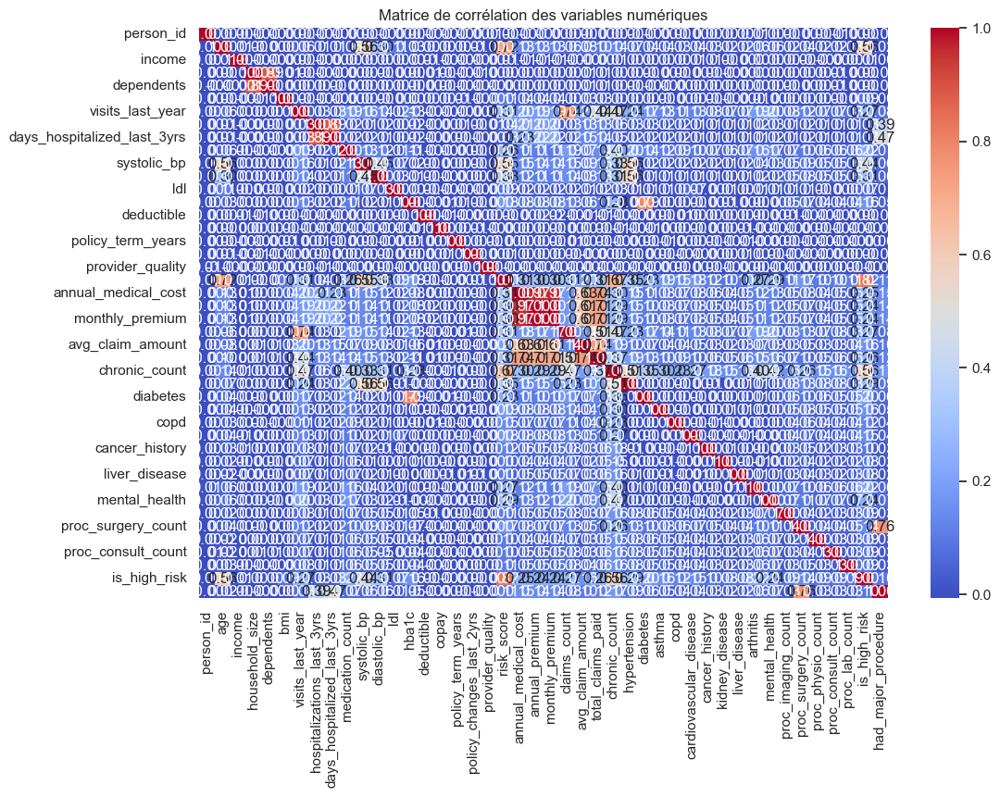

In [9]:
# Sélectionner uniquement les colonnes numériques
numeric_cols = df.select_dtypes(include=['int64', 'float64']).columns

# Calcul des corrélations uniquement sur les colonnes numériques
corr_matrix = df[numeric_cols].corr()

# Heatmap
plt.figure(figsize=(12,8))
sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap="coolwarm")
plt.title("Matrice de corrélation des variables numériques")
plt.show()


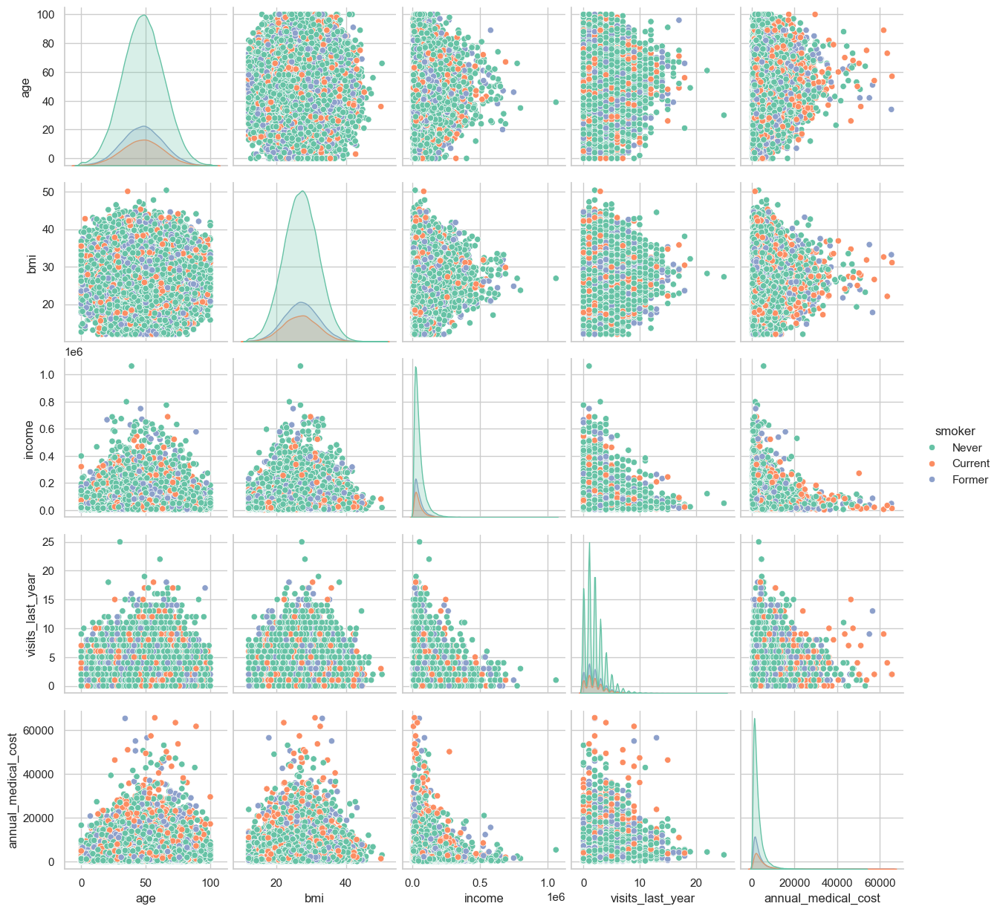

In [15]:
# Variables numériques importantes pour visualisation
cols_to_plot = ['age', 'bmi', 'income', 'visits_last_year', 'annual_medical_cost']

# Pairplot avec hue='smoker'
sns.pairplot(df[cols_to_plot + ['smoker']], hue='smoker', diag_kind='kde', palette='Set2')
plt.show()

### important de repérer les valeurs extrêmes qui pourraient fausser les modèles.

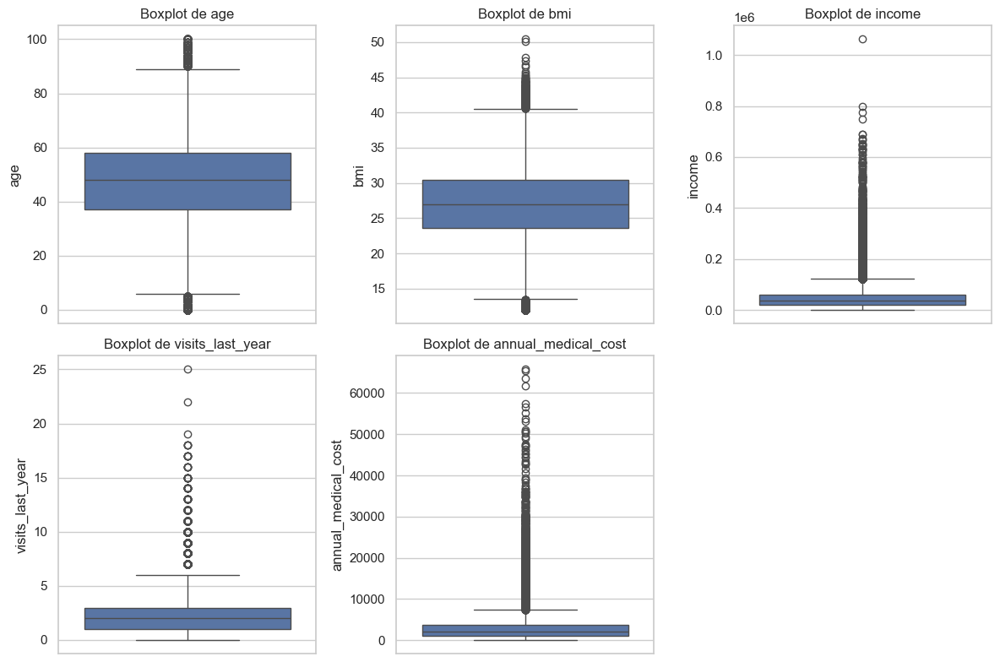

In [12]:
# Boxplots pour détecter les outliers
numeric_cols = ['age', 'bmi', 'income', 'visits_last_year', 'annual_medical_cost']

plt.figure(figsize=(12,8))
for i, col in enumerate(numeric_cols, 1):
    plt.subplot(2, 3, i)
    sns.boxplot(y=df[col])
    plt.title(f"Boxplot de {col}")
plt.tight_layout()
plt.show()


### Transformation des variables skewed (non linéaires)

age                    0.006039
bmi                    0.016151
income                 3.390437
visits_last_year       1.598202
annual_medical_cost    4.030318
dtype: float64


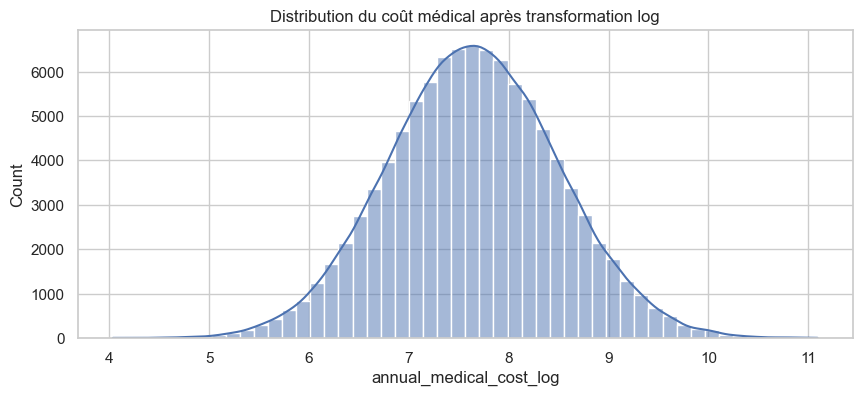

In [14]:
# Vérifier la skewness
print(df[numeric_cols].skew())

# Transformation log pour réduire la skewness
df['annual_medical_cost_log'] = np.log1p(df['annual_medical_cost'])
df['income_log'] = np.log1p(df['income'])

# Vérification de la distribution après transformation
plt.figure(figsize=(10,4))
sns.histplot(df['annual_medical_cost_log'], bins=50, kde=True)
plt.title("Distribution du coût médical après transformation log")
plt.show()


## Préparation des données

In [16]:
# Séparer la cible
y = df['annual_medical_cost']
X = df.drop('annual_medical_cost', axis=1)

# Colonnes catégorielles
cat_cols = X.select_dtypes(include='object').columns

# Encoder les colonnes catégorielles
X_encoded = pd.get_dummies(X, columns=cat_cols, drop_first=True)

# Normaliser les colonnes numériques
num_cols = X.select_dtypes(include=['int64','float64']).columns
scaler = StandardScaler()
X_encoded[num_cols] = scaler.fit_transform(X_encoded[num_cols])

X_encoded.shape


(100000, 74)

## Division train/test

In [17]:
X_train, X_test, y_train, y_test = train_test_split(
    X_encoded, y, test_size=0.2, random_state=42
)


## Entraînement du modèle FSM

In [18]:
model = LinearRegression()
model.fit(X_train, y_train)


LinearRegression()

## Prédictions et évaluation

In [19]:
y_pred = model.predict(X_test)

# MSE, RMSE, R²
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

print("Mean Squared Error (MSE) :", mse)
print("Root Mean Squared Error (RMSE) :", rmse)
print("R² Score :", r2)


Mean Squared Error (MSE) : 303621.4514588636
Root Mean Squared Error (RMSE) : 551.0185581800886
R² Score : 0.9691446267774219


## Visualisation des performances

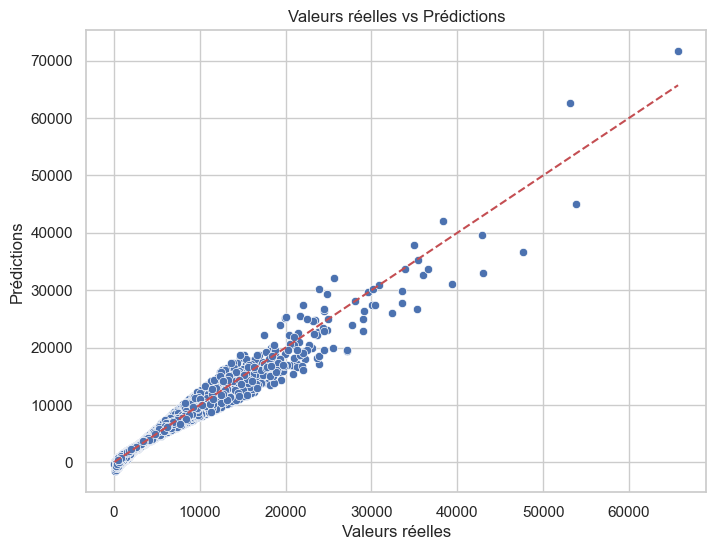

In [20]:
plt.figure(figsize=(8,6))
sns.scatterplot(x=y_test, y=y_pred)
plt.xlabel("Valeurs réelles")
plt.ylabel("Prédictions")
plt.title("Valeurs réelles vs Prédictions")
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--')
plt.show()


## Feature Importance simple

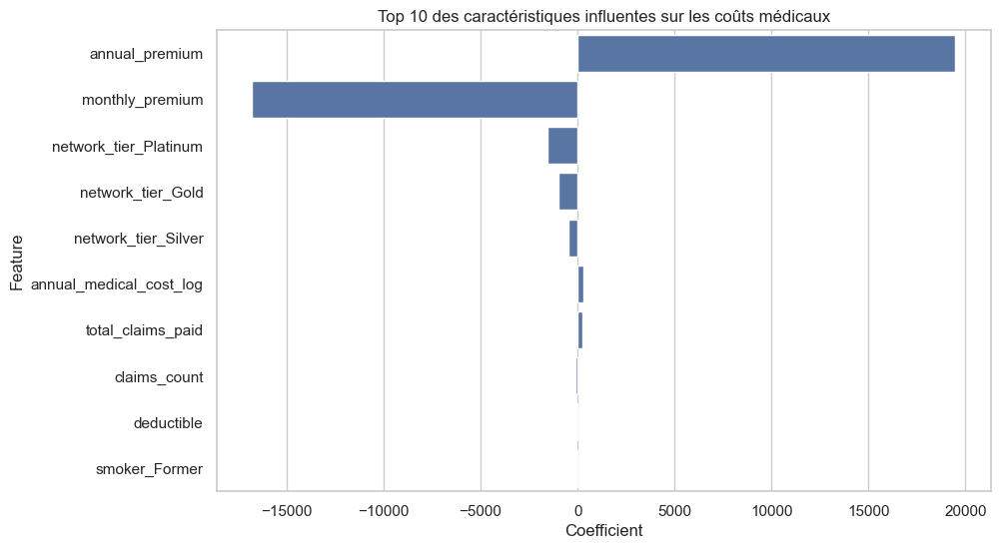

In [22]:
# Coefficients du modèle
coef_df = pd.DataFrame({
    'Feature': X_encoded.columns,
    'Coefficient': model.coef_
}).sort_values(by='Coefficient', key=abs, ascending=False)

# Top 10 caractéristiques influentes
plt.figure(figsize=(10,6))
sns.barplot(x='Coefficient', y='Feature', data=coef_df.head(10))
plt.title("Top 10 des caractéristiques influentes sur les coûts médicaux")
plt.show()


## Clustering KMeans

In [23]:
# Clustering KMeans (4 clusters)
kmeans = KMeans(n_clusters=4, random_state=42)
df['cluster'] = kmeans.fit_predict(X_encoded)

# Score silhouette
sil_score = silhouette_score(X_encoded, df['cluster'])
print(f"Silhouette Score : {sil_score:.2f}")


Silhouette Score : 0.10


## Visualisation des clusters (PCA et t-SNE)

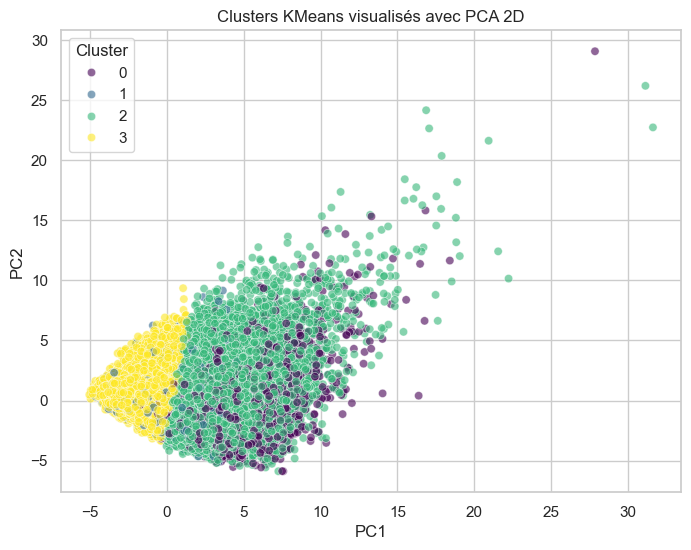

In [24]:
# PCA 2D
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_encoded)

plt.figure(figsize=(8,6))
sns.scatterplot(x=X_pca[:,0], y=X_pca[:,1], hue=df['cluster'], palette='viridis', alpha=0.6)
plt.title("Clusters KMeans visualisés avec PCA 2D")
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.legend(title='Cluster')
plt.show()


In [25]:
# ==============================
# Analyse inter-clusters (ANOVA)
# ==============================
features_to_test = ['age', 'bmi', 'visits_last_year', 'annual_premium']
for f in features_to_test:
    groups = [df[df['cluster']==k][f] for k in df['cluster'].unique()]
    f_val, p_val = f_oneway(*groups)
    print(f"Feature: {f} | F-value: {f_val:.2f} | p-value: {p_val:.4f}")


Feature: age | F-value: 5002.52 | p-value: 0.0000
Feature: bmi | F-value: 67.25 | p-value: 0.0000
Feature: visits_last_year | F-value: 6370.53 | p-value: 0.0000
Feature: annual_premium | F-value: 6432.35 | p-value: 0.0000


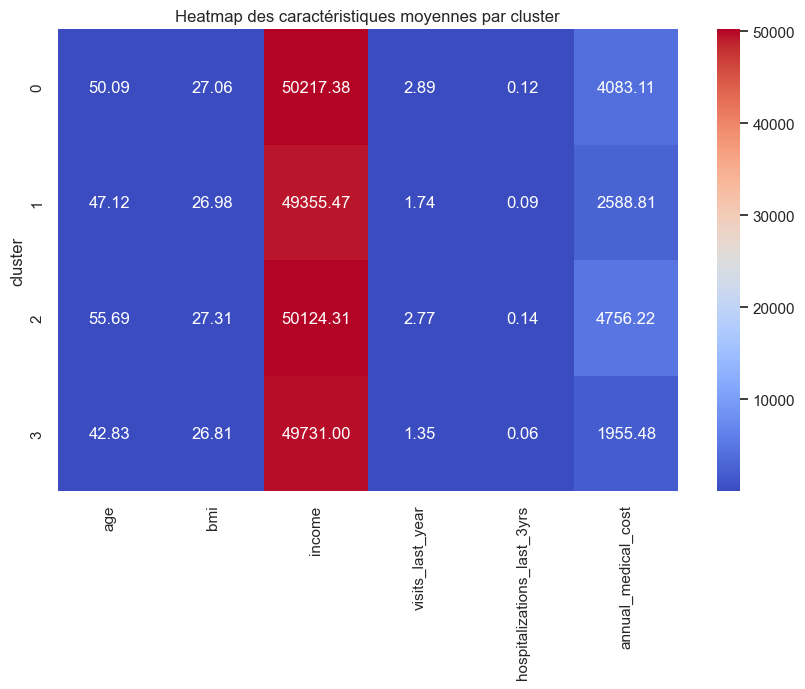

In [26]:

# Heatmap des moyennes par cluster
cluster_means = df.groupby('cluster')[['age','bmi','income','visits_last_year','hospitalizations_last_3yrs','annual_medical_cost']].mean()
plt.figure(figsize=(10,6))
sns.heatmap(cluster_means, annot=True, fmt=".2f", cmap='coolwarm')
plt.title("Heatmap des caractéristiques moyennes par cluster")
plt.show()


In [28]:
corr_cost = corr_matrix[['annual_medical_cost']].sort_values(by='annual_medical_cost', ascending=False)
print(corr_cost)


                             annual_medical_cost
annual_medical_cost                     1.000000
monthly_premium                         0.965416
annual_premium                          0.965415
annual_medical_cost_log                 0.826147
total_claims_paid                       0.739402
avg_claim_amount                        0.632996
risk_score                              0.305971
chronic_count                           0.296720
is_high_risk                            0.251923
days_hospitalized_last_3yrs             0.230246
hospitalizations_last_3yrs              0.208640
visits_last_year                        0.195631
claims_count                            0.179082
hypertension                            0.154309
had_major_procedure                     0.148292
systolic_bp                             0.145070
age                                     0.131166
mental_health                           0.126232
diastolic_bp                            0.117647
arthritis           

## Visualisations interactives ou multi-facteurs

### a) Coût médical vs âge vs fumeur (scatter interactif)

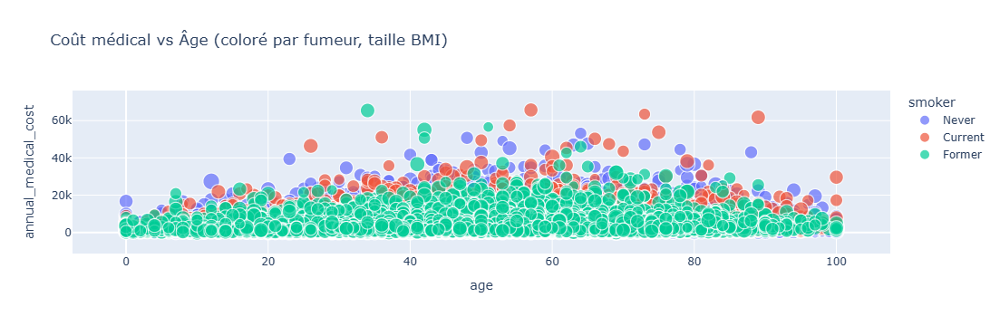

In [29]:
import plotly.express as px

fig = px.scatter(df, x='age', y='annual_medical_cost', color='smoker',
                 size='bmi', hover_data=['income', 'region'],
                 title="Coût médical vs Âge (coloré par fumeur, taille BMI)")
fig.show()


### b) Boxplot interactif pour comparer par catégorie

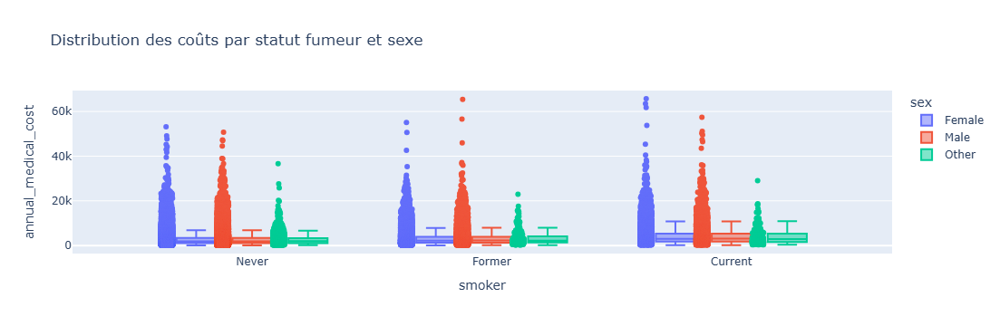

In [30]:
fig = px.box(df, x='smoker', y='annual_medical_cost', color='sex',
             points="all", title="Distribution des coûts par statut fumeur et sexe")
fig.show()


### c) Heatmap interactive de corrélation avec Plotly

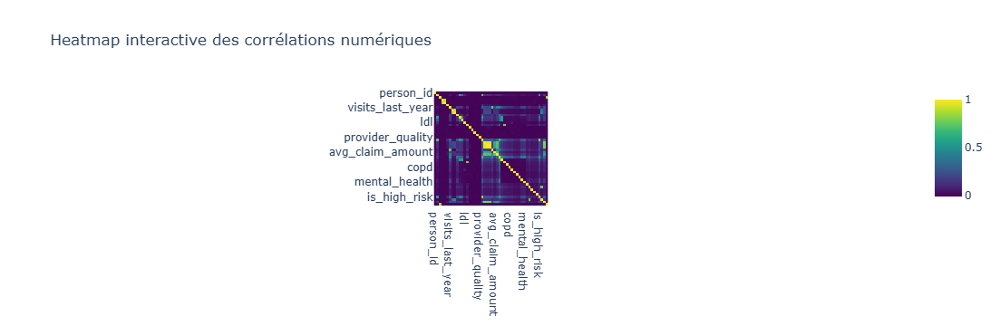

In [31]:
fig = px.imshow(corr_matrix, text_auto=True, color_continuous_scale='Viridis',
                title="Heatmap interactive des corrélations numériques")
fig.show()


## Évaluation des modèles avec confusion matrix interactive


--- Logistic Regression ---
Accuracy : 0.9983
F1 Score : 0.9982997832707415
Precision: 0.9983001643555297
Recall   : 0.9983

Classification Report :
               precision    recall  f1-score   support

           0       1.00      1.00      1.00      1635
           1       0.99      1.00      1.00       958
           2       1.00      1.00      1.00     11326
           3       1.00      1.00      1.00      6081

    accuracy                           1.00     20000
   macro avg       1.00      1.00      1.00     20000
weighted avg       1.00      1.00      1.00     20000



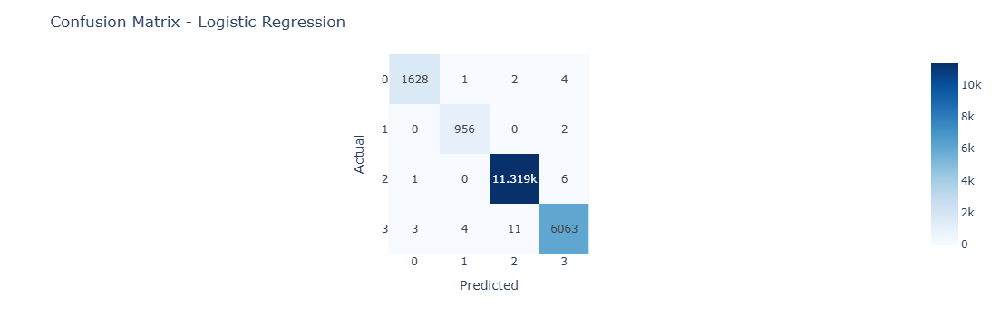


--- Random Forest ---
Accuracy : 0.9744
F1 Score : 0.9743587796993192
Precision: 0.9743646522747113
Recall   : 0.9744

Classification Report :
               precision    recall  f1-score   support

           0       0.98      1.00      0.99      1635
           1       1.00      0.99      0.99       958
           2       0.98      0.98      0.98     11326
           3       0.97      0.95      0.96      6081

    accuracy                           0.97     20000
   macro avg       0.98      0.98      0.98     20000
weighted avg       0.97      0.97      0.97     20000



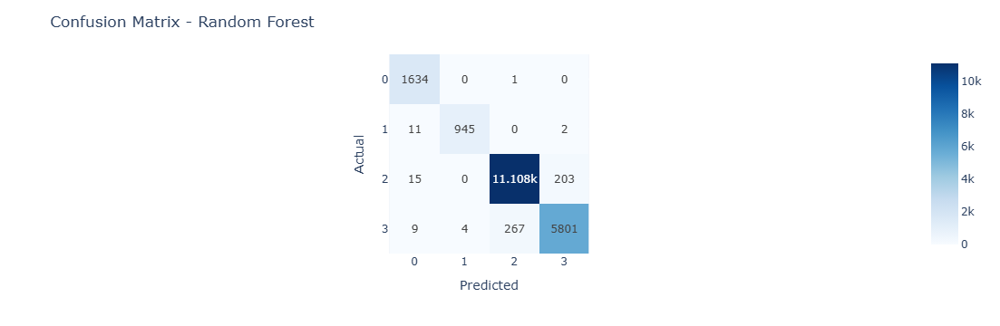


--- XGBoost ---
Accuracy : 0.98775
F1 Score : 0.9877418264693694
Precision: 0.9877406978786406
Recall   : 0.98775

Classification Report :
               precision    recall  f1-score   support

           0       0.99      1.00      0.99      1635
           1       0.99      0.99      0.99       958
           2       0.99      0.99      0.99     11326
           3       0.98      0.98      0.98      6081

    accuracy                           0.99     20000
   macro avg       0.99      0.99      0.99     20000
weighted avg       0.99      0.99      0.99     20000



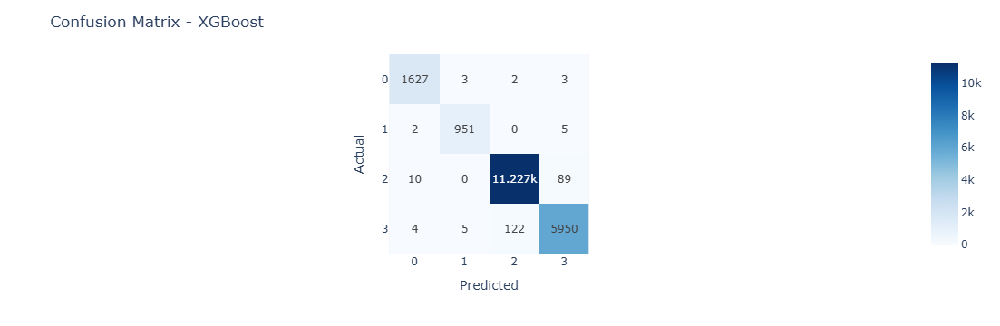

In [15]:
# ==============================
#  Évaluation et matrices de confusion
# ==============================
def evaluate_model(y_true, y_pred, model_name):
    print(f"\n--- {model_name} ---")
    print("Accuracy :", accuracy_score(y_true, y_pred))
    print("F1 Score :", f1_score(y_true, y_pred, average='weighted'))
    print("Precision:", precision_score(y_true, y_pred, average='weighted'))
    print("Recall   :", recall_score(y_true, y_pred, average='weighted'))
    print("\nClassification Report :\n", classification_report(y_true, y_pred))
    
    cm = confusion_matrix(y_true, y_pred)
    fig = px.imshow(cm, text_auto=True, color_continuous_scale='Blues')
    fig.update_layout(title=f'Confusion Matrix - {model_name}', xaxis_title="Predicted", yaxis_title="Actual")
    fig.show()

# Séparer features et target pour classification
y_clust = df['cluster']
X_clust = X_encoded.copy()

# Train/test
X_train_clust, X_test_clust, y_train_clust, y_test_clust = train_test_split(
    X_clust, y_clust, test_size=0.2, random_state=42
)

# Entraînement des modèles
lr_model = LogisticRegression(max_iter=500)
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)
xgb_model = XGBClassifier(use_label_encoder=False, eval_metric='mlogloss')

lr_model.fit(X_train_clust, y_train_clust)
rf_model.fit(X_train_clust, y_train_clust)
xgb_model.fit(X_train_clust, y_train_clust)

# Prédictions
y_pred_lr = lr_model.predict(X_test_clust)
y_pred_rf = rf_model.predict(X_test_clust)
y_pred_xgb = xgb_model.predict(X_test_clust)

# Évaluation
evaluate_model(y_test_clust, y_pred_lr, "Logistic Regression")
evaluate_model(y_test_clust, y_pred_rf, "Random Forest")
evaluate_model(y_test_clust, y_pred_xgb, "XGBoost")


In [17]:
from ipywidgets import interact

def show_cluster_stats(cluster_num):
    cluster_df = df[df['cluster']==cluster_num]
    display(cluster_df.describe())

interact(show_cluster_stats, cluster_num=(0, df['cluster'].nunique()-1))


interactive(children=(IntSlider(value=1, description='cluster_num', max=3), Output()), _dom_classes=('widget-i…

<function __main__.show_cluster_stats(cluster_num)>

In [18]:
for model, name in zip([lr_model, rf_model, xgb_model], ["LR","RF","XGB"]):
    scores = cross_val_score(model, X_clust, y_clust, cv=5, scoring='accuracy')
    print(f"{name} - Accuracy CV : {scores.mean():.3f} ± {scores.std():.3f}")


LR - Accuracy CV : 0.998 ± 0.000
RF - Accuracy CV : 0.973 ± 0.001
XGB - Accuracy CV : 0.987 ± 0.001


In [19]:
y_score = xgb_model.predict_proba(X_test_clust)
from sklearn.preprocessing import label_binarize
y_bin = label_binarize(y_test_clust, classes=range(df['cluster'].nunique()))
# calcul ROC par classe


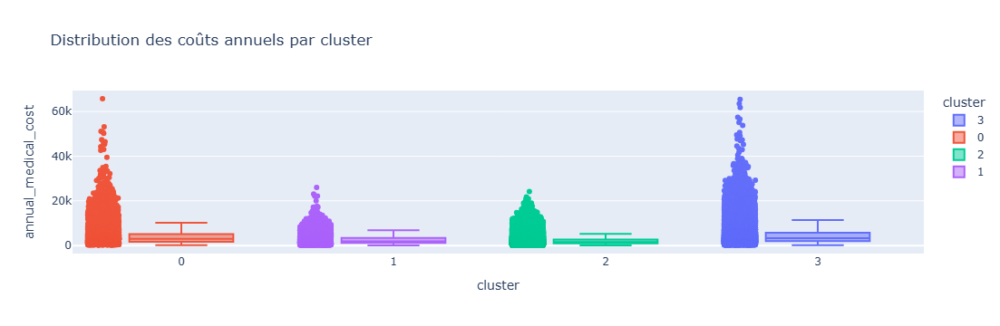

In [20]:
fig = px.box(df, x='cluster', y='annual_medical_cost', color='cluster', points="all",
             title="Distribution des coûts annuels par cluster")
fig.show()


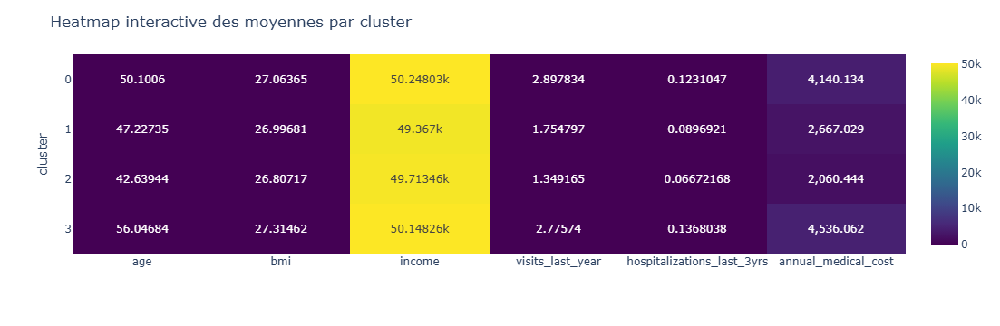

In [21]:
fig = px.imshow(cluster_means, text_auto=True, color_continuous_scale='Viridis')
fig.update_layout(title="Heatmap interactive des moyennes par cluster")
fig.show()


## Conclusion et utilité

Les clusters permettent d’identifier clairement les groupes de patients à faible risque et à haut risque.

Les visualisations (PCA 2D/3D, t-SNE, boxplots) offrent une compréhension globale de la distribution des individus et des caractéristiques importantes par cluster.

Les modèles prédictifs (Logistic Regression, Random Forest, XGBoost) démontrent leur capacité à classer correctement chaque individu dans son cluster.

Utilité pratique du projet :

Prévision des coûts médicaux pour une meilleure gestion financière.

Segmentation des patients pour des actions de prévention ciblées.

Allocation optimale des ressources médicales selon le niveau de risque.